In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.svm import SVR
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.metrics import *

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [2]:
%store -r df_train_3
%store -r df_test_3
%store -r df_RUL_3

In [4]:
unit = input("Write the unit engine number to get the sensor measurements: ")
unit_analysis = unit # chosen before

df_unit_n = df_train_3.query("ID==@unit_analysis")
filter_col = [col for col in df_train_3 if col.startswith('sensor_measurement_')]
df_unit_n_chosen = df_unit_n[filter_col]

df_unit_n_chosen["Cycle"] = df_unit_n["Cycle"]

df_std = df_unit_n_chosen[df_unit_n_chosen.columns[df_unit_n_chosen.std(axis=0) < 1e-5]]
df_std_list = df_std.columns.tolist()
print("Number of non-responsive sensors: ",
     len(df_std_list))

df_std_list

Write the unit engine number to get the sensor measurements: 11
Number of non-responsive sensors:  5


<ipython-input-4-62750823d470>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_unit_n_chosen["Cycle"] = df_unit_n["Cycle"]


['sensor_measurement_1',
 'sensor_measurement_5',
 'sensor_measurement_16',
 'sensor_measurement_18',
 'sensor_measurement_19']

In [5]:
df_train_3.drop(columns=df_std_list, inplace=True)
df_test_3.drop(columns=df_std_list, inplace=True)

In [9]:
max_cycle_dataset_3 = df_train_3.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_dataset_3 = max_cycle_dataset_3.rename(columns={"Cycle":"Max_cycle"})
df_class_3  = df_train_3.copy()
df_class_3 = df_class_3.merge(max_cycle_dataset_3, how="inner", on="ID")
df_class_3_sensor = df_class_3.groupby(["ID"])["sensor_measurement_10"].last().reset_index()
df_class_3_sensor = df_class_3_sensor.merge(df_class_3[["ID","Max_cycle"]], how="inner", on="ID")
df_class_3_sensor_group = df_class_3_sensor.drop_duplicates().reset_index().drop("index", axis=1)

In [10]:
df_class_3_sensor_group

,ID,sensor_measurement_10,Max_cycle
0,1,1.30,259
1,2,1.31,253
2,3,1.30,222
3,4,1.30,272
4,5,1.30,213
5,6,1.30,278
6,7,1.32,424
7,8,1.30,267
8,9,1.32,406
9,10,1.31,481


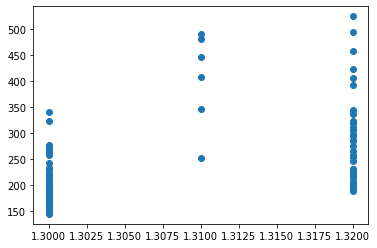

In [11]:
x = df_class_3_sensor_group["sensor_measurement_10"]
y = df_class_3_sensor_group["Max_cycle"]

plt.scatter(x,y)

In [13]:
sensor_columns = df_train_3.columns[4:-1]

In [17]:
sensor_columns = ['sensor_measurement_2',
 'sensor_measurement_3',
 'sensor_measurement_4',
 'sensor_measurement_6',
 'sensor_measurement_7',
 'sensor_measurement_8',
 'sensor_measurement_9',
 'sensor_measurement_10',
 'sensor_measurement_11',
 'sensor_measurement_12',
 'sensor_measurement_13',
 'sensor_measurement_14',
 'sensor_measurement_15',
 'sensor_measurement_17',
 'sensor_measurement_20',
 'sensor_measurement_21']

In [18]:
max_cycle_dataset_3 = df_train_3.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_dataset_3 = max_cycle_dataset_3.rename(columns={"Cycle":"Max_cycle"})
df_class_3  = df_train_3.copy()
df_class_3 = df_class_3.merge(max_cycle_dataset_3, how="inner", on="ID")

df_last = df_class_3.groupby("ID")[sensor_columns+["Max_cycle"]].last().reset_index()
df_last

,ID,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_6,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_10,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,Max_cycle
0,1,643.94,1599.54,1434.33,21.61,551.60,2388.25,9076.30,1.30,48.34,519.44,2388.23,8149.15,8.5313,398,38.35,23.0707,259
1,2,643.35,1595.93,1419.99,21.58,568.81,2388.53,9123.93,1.31,48.08,536.21,2388.51,8190.81,8.2588,397,39.72,23.8854,253
2,3,644.23,1598.25,1424.21,21.61,551.00,2388.20,9088.06,1.30,47.95,520.24,2388.17,8163.26,8.5020,396,38.37,23.1134,222
3,4,643.67,1597.02,1426.14,21.61,550.74,2388.32,9043.81,1.30,48.20,519.32,2388.34,8116.35,8.5314,397,38.42,23.0814,272
4,5,643.58,1608.57,1437.97,21.61,551.70,2388.18,9119.82,1.30,48.32,519.86,2388.21,8178.97,8.5134,397,38.23,23.0320,213
5,6,643.99,1604.79,1429.10,21.61,551.34,2388.26,9080.56,1.30,48.19,519.65,2388.27,8152.09,8.5181,397,38.39,23.0311,278
6,7,642.71,1607.40,1428.60,21.57,568.95,2388.46,9128.34,1.32,48.31,536.22,2388.53,8193.34,8.2187,396,39.47,23.6652,424
7,8,643.59,1600.18,1426.91,21.61,551.17,2388.28,9077.81,1.30,48.22,519.37,2388.23,8148.89,8.4872,398,38.47,23.0655,267
8,9,643.26,1600.80,1429.76,21.60,569.30,2388.52,9120.83,1.32,48.20,537.11,2388.51,8193.86,8.2254,398,39.72,23.7265,406
9,10,643.22,1607.41,1423.66,21.45,565.50,2388.39,9124.78,1.31,48.30,532.41,2388.37,8187.71,8.2211,395,39.51,23.5857,481


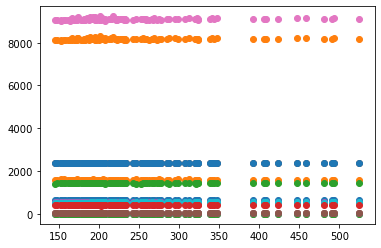

In [31]:
for x in sensor_columns:
    x = df_last[x]
    y = df_last["Max_cycle"]
    plt.scatter(y,x)

In [42]:
max_cycle_test_3 = df_test_3.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_test_3 = max_cycle_test_3.rename(columns={"Cycle":"Max_cycle"})
df_class_t3  = df_test_3.copy()
df_class_t3 = df_class_t3.merge(max_cycle_test_3, how="inner", on="ID")

df_lastt = df_class_t3.groupby("ID")[sensor_columns+["Max_cycle"]].last().reset_index()
df_lastt

,ID,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_6,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_10,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,Max_cycle
0,1,642.59,1592.40,1409.87,21.58,560.53,2388.22,9085.50,1.31,47.53,528.05,2388.23,8158.77,8.2966,393,39.43,23.5679,233
1,2,642.56,1587.42,1409.69,21.61,553.33,2388.18,9050.97,1.30,47.71,520.90,2388.17,8128.04,8.4514,392,38.83,23.2821,124
2,3,642.75,1591.93,1417.66,21.60,563.61,2388.31,9091.69,1.31,47.68,531.36,2388.33,8173.56,8.3057,395,39.27,23.6440,234
3,4,642.28,1584.68,1406.56,21.61,552.75,2388.07,9048.23,1.30,47.26,521.27,2388.09,8133.78,8.4337,392,38.70,23.3804,68
4,5,642.15,1580.59,1397.26,21.58,553.82,2387.96,9050.89,1.30,47.09,521.74,2387.96,8132.51,8.3900,390,38.89,23.4463,138
5,6,642.20,1588.28,1414.37,21.61,553.66,2388.05,9056.04,1.30,47.51,521.41,2388.03,8137.70,8.4386,393,39.13,23.2888,64
6,7,642.52,1593.45,1412.15,21.61,552.90,2388.17,9042.58,1.30,47.73,520.38,2388.15,8120.92,8.4414,394,38.66,23.2992,158
7,8,642.59,1590.27,1413.67,21.61,552.84,2388.12,9050.27,1.30,47.81,521.06,2388.18,8130.22,8.4530,393,38.87,23.2436,192
8,9,643.02,1589.19,1412.59,21.61,552.93,2388.14,9058.59,1.30,47.64,521.13,2388.05,8133.84,8.4333,395,38.79,23.2167,238
9,10,643.33,1587.62,1403.57,21.61,553.89,2388.04,9063.04,1.30,47.39,521.57,2388.03,8152.28,8.4542,393,38.96,23.4555,131


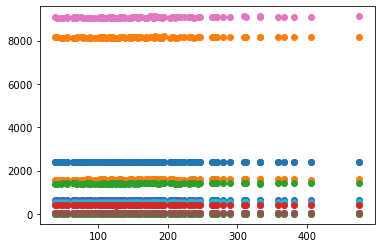

In [43]:
for x in sensor_columns:
    x = df_lastt[x]
    y = df_lastt["Max_cycle"]
    plt.scatter(y,x)

# IMPORTANTE

con esto estamos probando que el Max_cycle life no es un parámetro valido para estudiar si se está cayendo en un tipo de fallo o en otro.

En el train, parecía que un tipo de fallo hacia que los motores dejasen de funcionar antes o después de 350 ciclos, sin embargo, aqui no se está cumpliendo esa division

----------------

Habría que tratar de analizar directamente el comportamiento de los sensores, y detectar cuales de ellos son realmente representativos del tipo de fallo

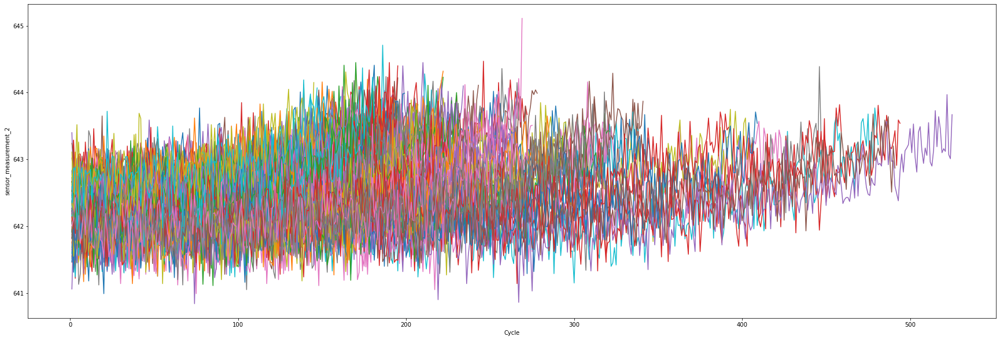

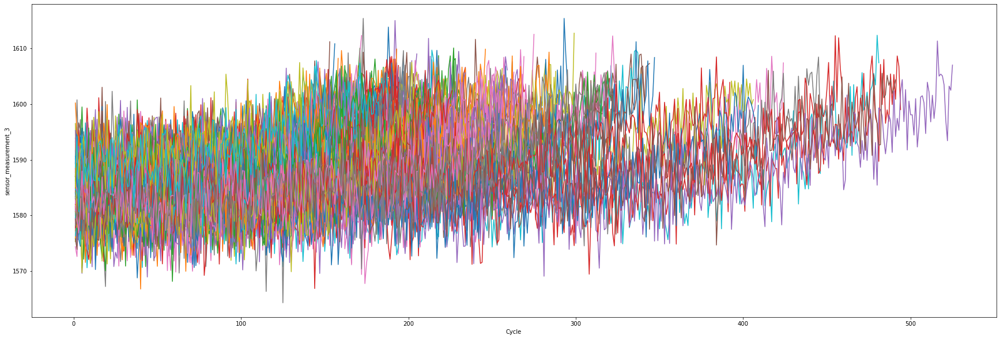

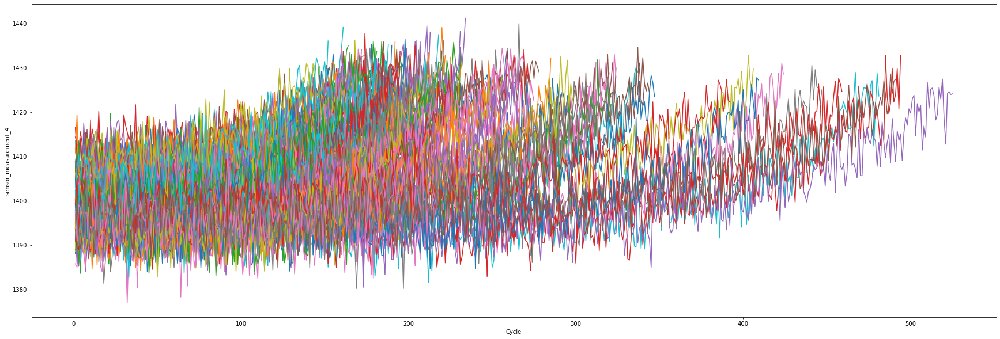

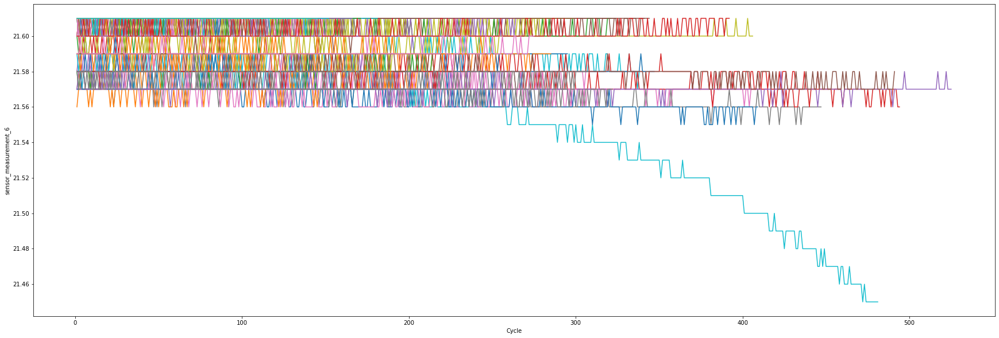

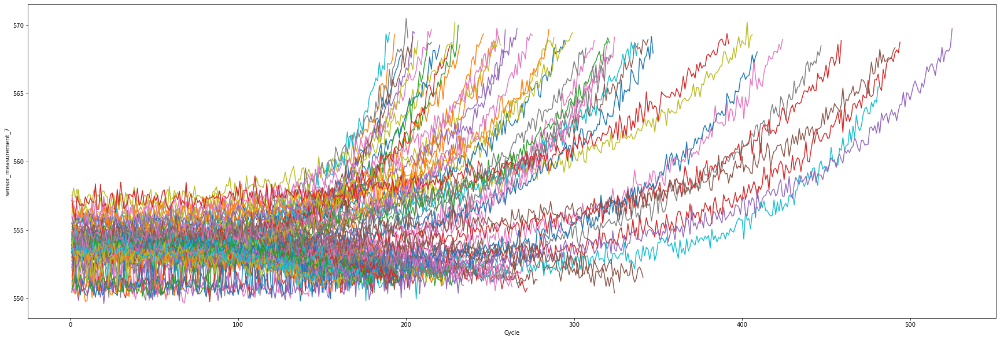

...

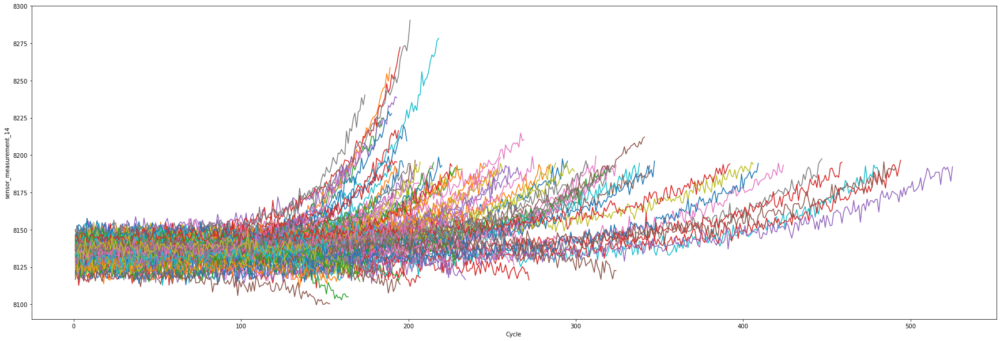

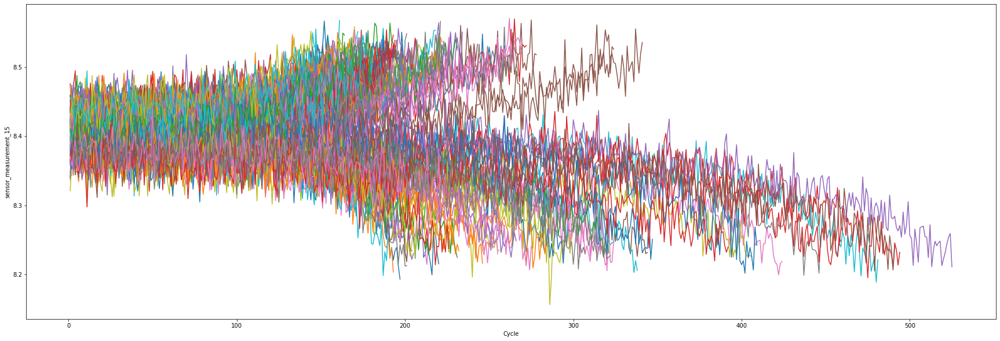

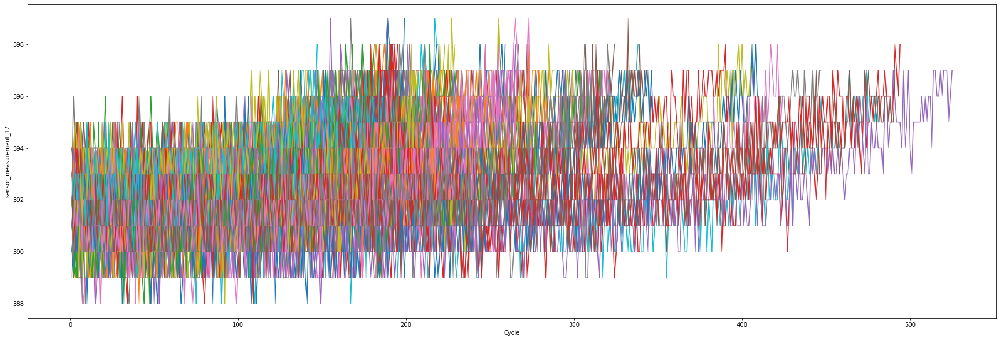

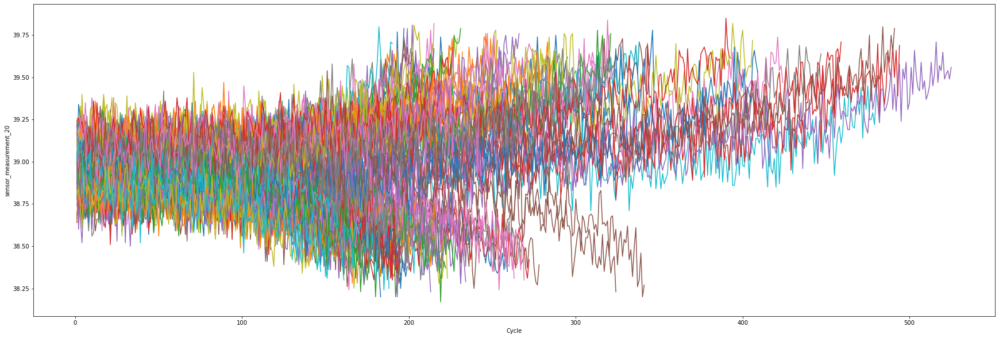

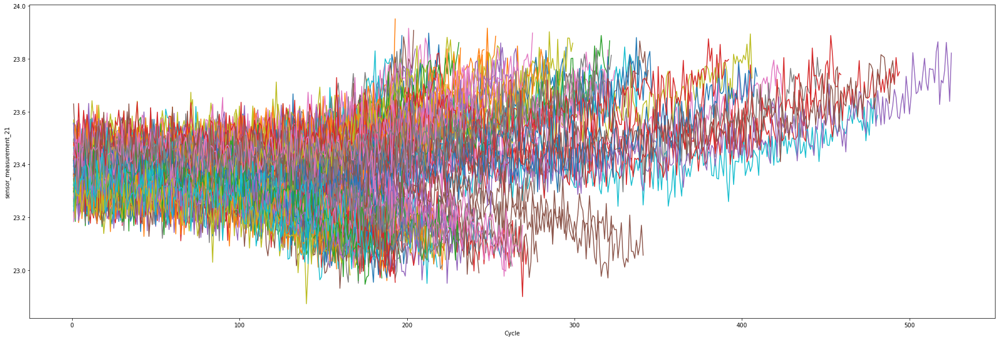

In [45]:
sensor_columns = df_train_3.columns[5:-1].tolist()
for col in sensor_columns:
    
    df = df_train_3[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

De momento podemos anotar los sensores cuyo comportamiento PUEDE SER susceptible de mostrar un fallo u otro:

- Sensor 8, 13
- Sensor 10 (este es mu raro)
- Sensores 12,14,15,20,21 (estos está más claro)

#### Los analizamos uno a uno

## Sensor 8

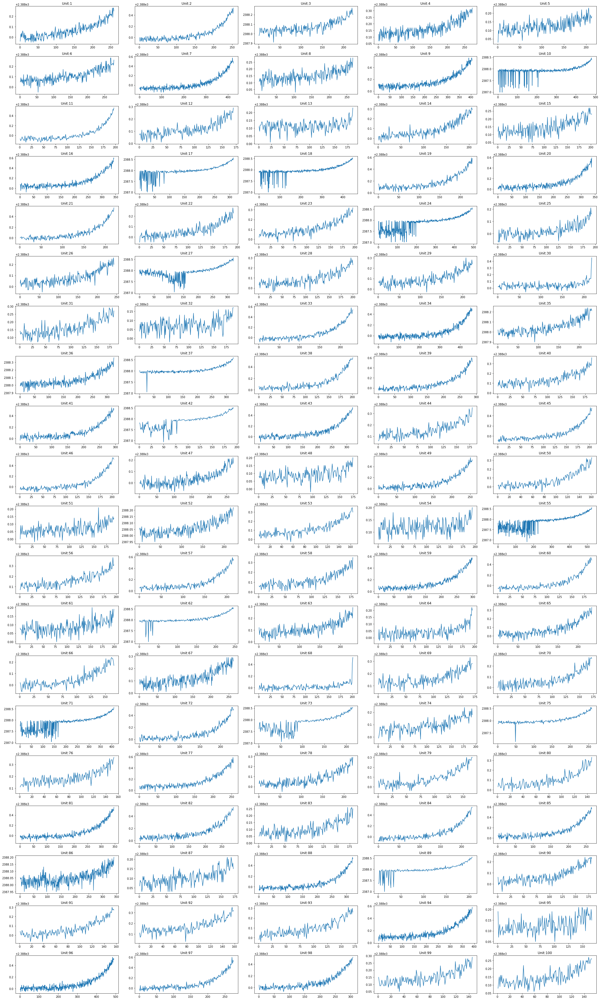

In [58]:
import seaborn as sns
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "sensor_measurement_8", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")
    #print("for ID {}, the minimum sensor value reached is: ".format(i), df_train_3["sensor_measurement_8"].min())

plt.tight_layout()

En principio, aunque pareciera que su comportamiento dista de un motor a otro, su variación se limita unicamente a la primera mitad, y finalmente independientemente de si ha tenido esa etapa o no, la tendencia es al alza, por lo que se puede intuir que no juega un papel relevante en el tipo de fallo

Analicemos más detenidamente los dos tipos de gráficas que nos encontramos con este sensor:

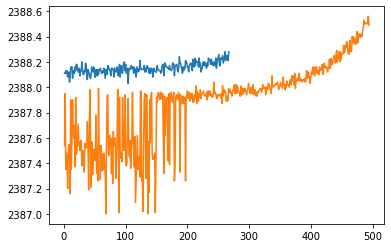

In [115]:
df_8_G1 = df_train_3[df_train_3["ID"]==8]
plt.plot(df_8_G1["Cycle"], df_8_G1["sensor_measurement_8"])
df_8_G2 = df_train_3[df_train_3["ID"]==24]
plt.plot(df_8_G2["Cycle"], df_8_G2["sensor_measurement_8"])

En principio, aunque pareciera que su comportamiento dista de un motor a otro, su variación se limita unicamente a la primera mitad, y finalmente independientemente de si ha tenido esa etapa o no, la tendencia es al alza, sin embargo, sí que se aprecia que los Ids que han tenido esa brusca variacion al principio, llegan a ciclos casi el doble de avanzados que el otro grupo

In [59]:
df_train_3[df_train_3["ID"]==10]["sensor_measurement_8"].min()

2386.99

In [94]:
minimums = []
maximums = []
for i in range(1,101):
    print("For Engine {}, the minimum sensor8 achieved is: ".format(i), df_train_3[df_train_3["ID"]==i]["sensor_measurement_8"].min())
    print("The maximum cycle achieved in this engine is: ", df_train_3[df_train_3["ID"]==i]["Cycle"].max(), "\n")
    minimums.append(df_train_3[df_train_3["ID"]==i]["sensor_measurement_8"].min())
    maximums.append(df_train_3[df_train_3["ID"]==i]["Cycle"].max())

For Engine 1, the minimum sensor8 achieved is:  2387.95
The maximum cycle achieved in this engine is:  259 

For Engine 2, the minimum sensor8 achieved is:  2387.91
The maximum cycle achieved in this engine is:  253 

For Engine 3, the minimum sensor8 achieved is:  2387.91
The maximum cycle achieved in this engine is:  222 

For Engine 4, the minimum sensor8 achieved is:  2388.06
The maximum cycle achieved in this engine is:  272 

For Engine 5, the minimum sensor8 achieved is:  2388.03
The maximum cycle achieved in this engine is:  213 

For Engine 6, the minimum sensor8 achieved is:  2387.95
The maximum cycle achieved in this engine is:  278 

For Engine 7, the minimum sensor8 achieved is:  2387.85
The maximum cycle achieved in this engine is:  424 

For Engine 8, the minimum sensor8 achieved is:  2388.03
The maximum cycle achieved in this engine is:  267 

For Engine 9, the minimum sensor8 achieved is:  2387.98
The maximum cycle achieved in this engine is:  406 

For Engine 10, the 

For Engine 99, the minimum sensor8 achieved is:  2388.05
The maximum cycle achieved in this engine is:  145 

For Engine 100, the minimum sensor8 achieved is:  2388.06
The maximum cycle achieved in this engine is:  152 



(array([ 8.,  4.,  1.,  0.,  0.,  0.,  0.,  0., 42., 45.]),
 array([2386.9  , 2387.017, 2387.134, 2387.251, 2387.368, 2387.485,
        2387.602, 2387.719, 2387.836, 2387.953, 2388.07 ]),
 <BarContainer object of 10 artists>)

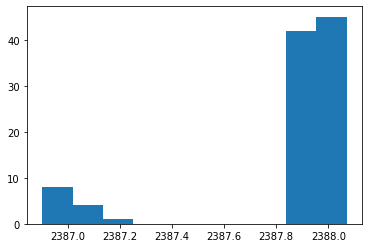

In [67]:
plt.hist(minimums)

Podemos sacar fácilmente una clara división en dos grupos haciendo caso al mínimo alcanzado en cada uno de los motores según este sensor, vamos a sacar los IDs respectivos de cada uno

In [83]:
threshold = 2387.5

def condition(x): return x > 2387.5

sensor_8_G1 = [idx+1 for idx, element in enumerate(minimums) if condition(element)]

def condition2(x): return x <= 2387.5

sensor_8_G2 = [idx+1 for idx, element in enumerate(minimums) if condition2(element)]

In [84]:
sensor_8_G1

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 11,
 12,
 13,
 14,
 15,
 16,
 19,
 20,
 21,
 22,
 23,
 25,
 26,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 38,
 39,
 40,
 41,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 56,
 57,
 58,
 59,
 60,
 61,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 72,
 74,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100]

In [85]:
sensor_8_G2

[10, 17, 18, 24, 27, 37, 42, 55, 62, 71, 73, 75, 89]

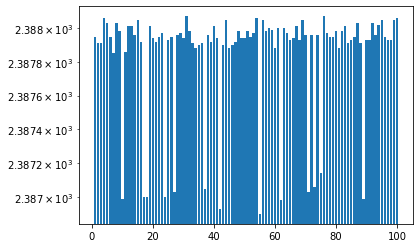

In [102]:
plt.bar(range(1,101), minimums)
plt.yscale("log")


<BarContainer object of 100 artists>

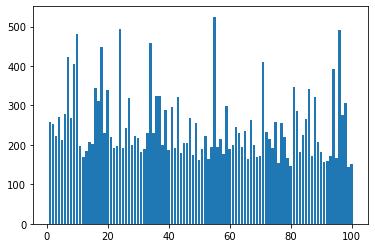

In [101]:
plt.bar(range(1,101), maximums)

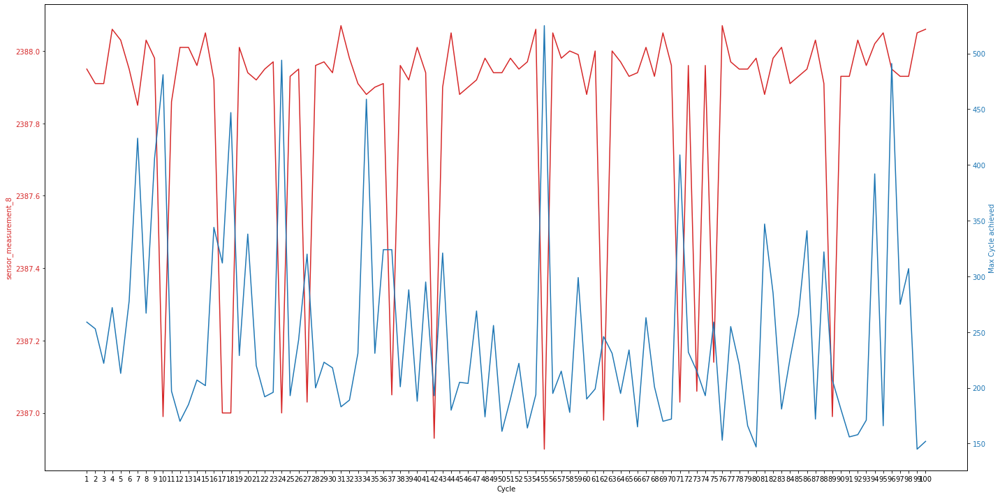

In [109]:
t = range(1,101)
data1 = minimums
data2 = maximums

fig, ax1 = plt.subplots(figsize=(20,10))

color = 'tab:red'
ax1.set_xlabel('Cycle')
ax1.set_xticks(range(1,101))
ax1.set_ylabel("sensor_measurement_8", color=color)
ax1.plot(t, data1, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Max Cycle achieved', color=color)  # we already handled the x-label with ax1
ax2.plot(t, data2, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

No ocurre en todos los casos, pero parece que los motores que tienen la variacion que les hace llegar a valores más bajos de este sensor, consiguen llegar a ciclos más altos

Parece que podemos tener una clara división, ya que el hecho de que tenga o no esta fuerte variación al principio parece determinar que el motor llegue o no a ciclos más avanzados

## Sensor 13

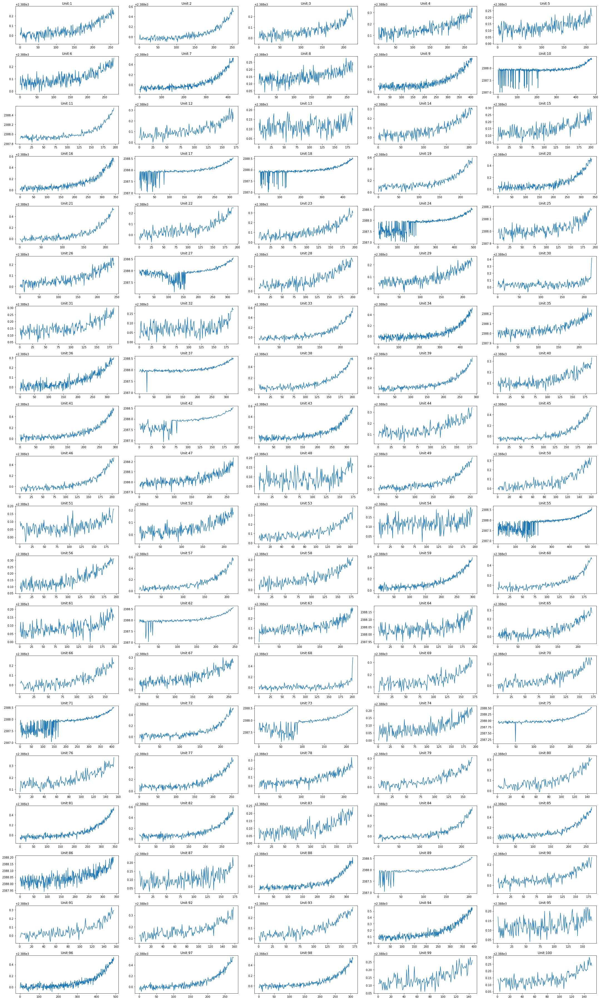

In [47]:
import seaborn as sns
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "sensor_measurement_13", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

El sensor 13 de primeras parece tener un comportamiento similar al 8, vamos a analizarlo en profundiad

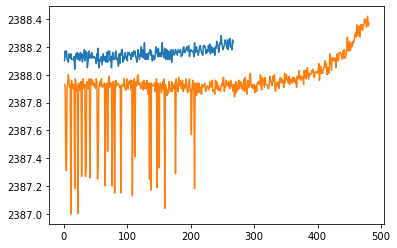

In [130]:
df_13_G1 = df_train_3[df_train_3["ID"]==8]
plt.plot(df_13_G1["Cycle"], df_13_G1["sensor_measurement_13"])
df_13_G2 = df_train_3[df_train_3["ID"]==10]
plt.plot(df_13_G2["Cycle"], df_13_G2["sensor_measurement_13"])

A primera vista parece que se da la misma diferenciación

In [122]:
minimums = []
maximums = []
for i in range(1,101):
    print("For Engine {}, the minimum sensor13 achieved is: ".format(i), df_train_3[df_train_3["ID"]==i]["sensor_measurement_13"].min())
    print("The maximum cycle achieved in this engine is: ", df_train_3[df_train_3["ID"]==i]["Cycle"].max(), "\n")
    minimums.append(df_train_3[df_train_3["ID"]==i]["sensor_measurement_13"].min())
    maximums.append(df_train_3[df_train_3["ID"]==i]["Cycle"].max())

For Engine 1, the minimum sensor13 achieved is:  2387.93
The maximum cycle achieved in this engine is:  259 

For Engine 2, the minimum sensor13 achieved is:  2387.89
The maximum cycle achieved in this engine is:  253 

For Engine 3, the minimum sensor13 achieved is:  2387.96
The maximum cycle achieved in this engine is:  222 

For Engine 4, the minimum sensor13 achieved is:  2388.04
The maximum cycle achieved in this engine is:  272 

For Engine 5, the minimum sensor13 achieved is:  2388.01
The maximum cycle achieved in this engine is:  213 

For Engine 6, the minimum sensor13 achieved is:  2387.99
The maximum cycle achieved in this engine is:  278 

For Engine 7, the minimum sensor13 achieved is:  2387.85
The maximum cycle achieved in this engine is:  424 

For Engine 8, the minimum sensor13 achieved is:  2388.04
The maximum cycle achieved in this engine is:  267 

For Engine 9, the minimum sensor13 achieved is:  2387.99
The maximum cycle achieved in this engine is:  406 

For Engine

For Engine 78, the minimum sensor13 achieved is:  2387.93
The maximum cycle achieved in this engine is:  221 

For Engine 79, the minimum sensor13 achieved is:  2387.95
The maximum cycle achieved in this engine is:  166 

For Engine 80, the minimum sensor13 achieved is:  2387.99
The maximum cycle achieved in this engine is:  147 

For Engine 81, the minimum sensor13 achieved is:  2387.87
The maximum cycle achieved in this engine is:  347 

For Engine 82, the minimum sensor13 achieved is:  2387.95
The maximum cycle achieved in this engine is:  285 

For Engine 83, the minimum sensor13 achieved is:  2388.01
The maximum cycle achieved in this engine is:  181 

For Engine 84, the minimum sensor13 achieved is:  2387.89
The maximum cycle achieved in this engine is:  226 

For Engine 85, the minimum sensor13 achieved is:  2387.92
The maximum cycle achieved in this engine is:  266 

For Engine 86, the minimum sensor13 achieved is:  2387.94
The maximum cycle achieved in this engine is:  341 

F

(array([10.,  2.,  1.,  0.,  0.,  0.,  0.,  1., 47., 39.]),
 array([2386.93 , 2387.045, 2387.16 , 2387.275, 2387.39 , 2387.505,
        2387.62 , 2387.735, 2387.85 , 2387.965, 2388.08 ]),
 <BarContainer object of 10 artists>)

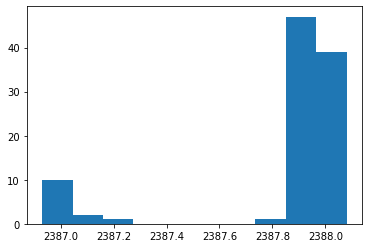

In [132]:
plt.hist(minimums)

La división en dos subgrupos es prácticamente la misma, así como los valores que hacen de esta clasificación

In [133]:
threshold = 2387.5

def condition(x): return x > 2387.5

sensor_13_G1 = [idx+1 for idx, element in enumerate(minimums) if condition(element)]

def condition2(x): return x <= 2387.5

sensor_13_G2 = [idx+1 for idx, element in enumerate(minimums) if condition2(element)]

In [135]:
sensor_13_G1

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 11,
 12,
 13,
 14,
 15,
 16,
 19,
 20,
 21,
 22,
 23,
 25,
 26,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 38,
 39,
 40,
 41,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 56,
 57,
 58,
 59,
 60,
 61,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 72,
 74,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100]

In [134]:
sensor_13_G2

[10, 17, 18, 24, 27, 37, 42, 55, 62, 71, 73, 75, 89]

Comprobemos:

In [136]:
sensor_8_G1 == sensor_13_G1

True

In [139]:
sensor_8_G2 == sensor_13_G2

True

Confirmado, ambos sensores actúan de la misma manera

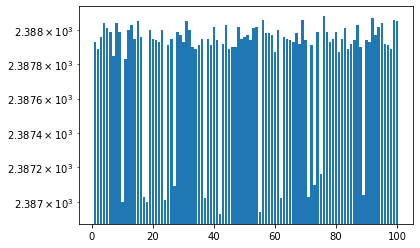

In [140]:
plt.bar(range(1,101), minimums)
plt.yscale("log")


<BarContainer object of 100 artists>

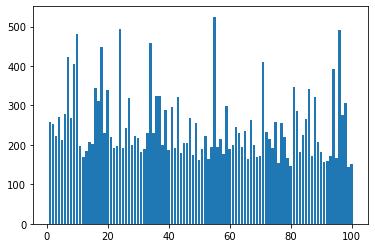

In [141]:
plt.bar(range(1,101), maximums)

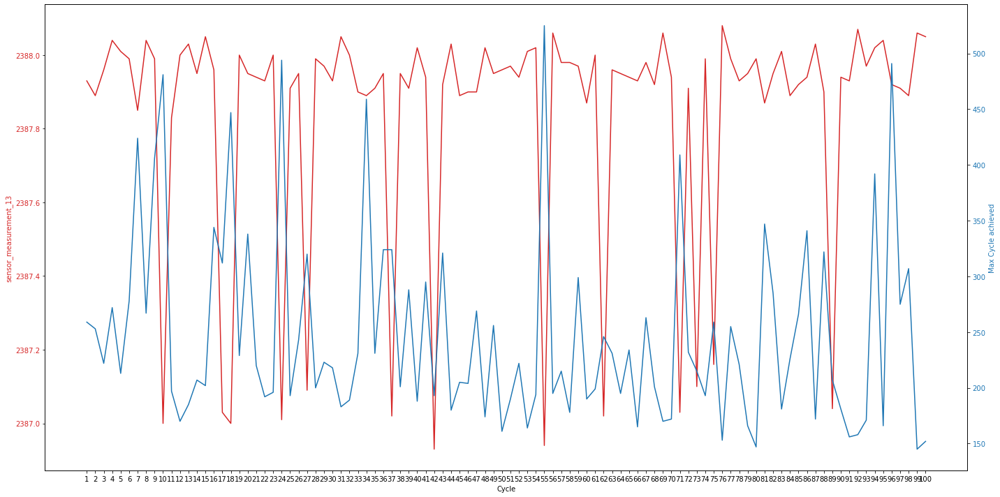

In [142]:
t = range(1,101)
data1 = minimums
data2 = maximums

fig, ax1 = plt.subplots(figsize=(20,10))

color = 'tab:red'
ax1.set_xlabel('Cycle')
ax1.set_xticks(range(1,101))
ax1.set_ylabel("sensor_measurement_13", color=color)
ax1.plot(t, data1, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Max Cycle achieved', color=color)  # we already handled the x-label with ax1
ax2.plot(t, data2, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

## Sensor 10

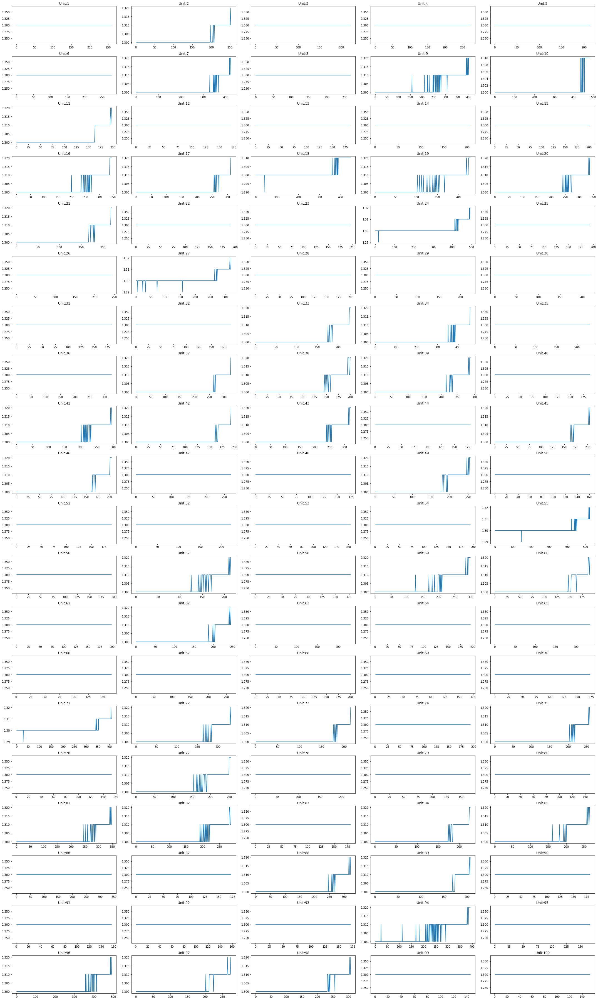

In [143]:
import seaborn as sns
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "sensor_measurement_10", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

Initially, we see 2 different classes in this sensor measurement: engines with no variation in this sensor through performance and engines which at certain point have sudden step variation(at 2 levels)

In [147]:
constants = []
not_constants = []
for i in range(1,101):
    if df_train_3[df_train_3["ID"]==i]["sensor_measurement_10"].std() < 1e-10:
        constants.append(i)
    else:
        not_constants.append(i)

In [149]:
print(len(not_constants), len(constants))

44 56


In [150]:
not_constants

[2,
 7,
 9,
 10,
 11,
 16,
 17,
 18,
 19,
 20,
 21,
 24,
 27,
 33,
 34,
 37,
 38,
 39,
 41,
 42,
 43,
 45,
 46,
 49,
 55,
 57,
 59,
 60,
 62,
 71,
 72,
 73,
 75,
 77,
 81,
 82,
 84,
 85,
 88,
 89,
 94,
 96,
 97,
 98]

In [151]:
cycles_const = []
cycles_not_const = []
for i in not_constants:
    cycles_not_const.append(df_train_3[df_train_3["ID"]==i]["Cycle"].max())
for j in constants:
    cycles_const.append(df_train_3[df_train_3["ID"]==j]["Cycle"].max())

In [156]:
print("Mean max_cycle value of constant s10 engines: ", sum(cycles_const) / len(cycles_const), "\n",
     "Mean max_cycle value of NON-constant s10 engines: ", sum(cycles_not_const) / len(cycles_not_const))

Mean max_cycle value of constant s10 engines:  202.05357142857142 
 Mean max_cycle value of NON-constant s10 engines:  304.65909090909093


We see a clear difference in terms of maximum cycles reached by each type of group

In [157]:
sensor_13_G2

[10, 17, 18, 24, 27, 37, 42, 55, 62, 71, 73, 75, 89]

In [162]:
list(set(sensor_13_G2) - set(not_constants))

[]

All engines in G2 from sensors 8 and 13 are covered in sensor 10, but the opposite leaves many engines out of the categorization

In [165]:
difference_8_10 = list(set(not_constants) - set(sensor_13_G2))
max_cycles_diff = []
for i in difference_8_10:
    max_Cy = df_train_3[df_train_3["ID"]==i]["Cycle"].max()
    max_cycles_diff.append(max_Cy)
print(sum(max_cycles_diff) / len(max_cycles_diff))

289.4516129032258


A bit lower, but still higher than the mean of the first group...

We'll see afterwards what to do with this

## Sensor 12

Esto es muy interesante, parece que las conclusiones a las que habiamos llegado antes de la relacion entre el sensor y la duracion de los ciclos pueden no tener nada que ver ahora con la evolucion de los siguientes sensores

Lo que yo haria seria estudiar en el siguiente orden:
1. Valores maximos y minimos alcanzados por cada engine
2. Si no sirve, sacar la regression linear (unicamente saber si es positiva o negativa) para hacer una distincion entre los sensores y asi tener una clasificacion en dos tipos (parriba o pabajo)
3. Aplicar esto a los siguientes sensores: 14,15,20,21 y ver que conclusiones sacamos

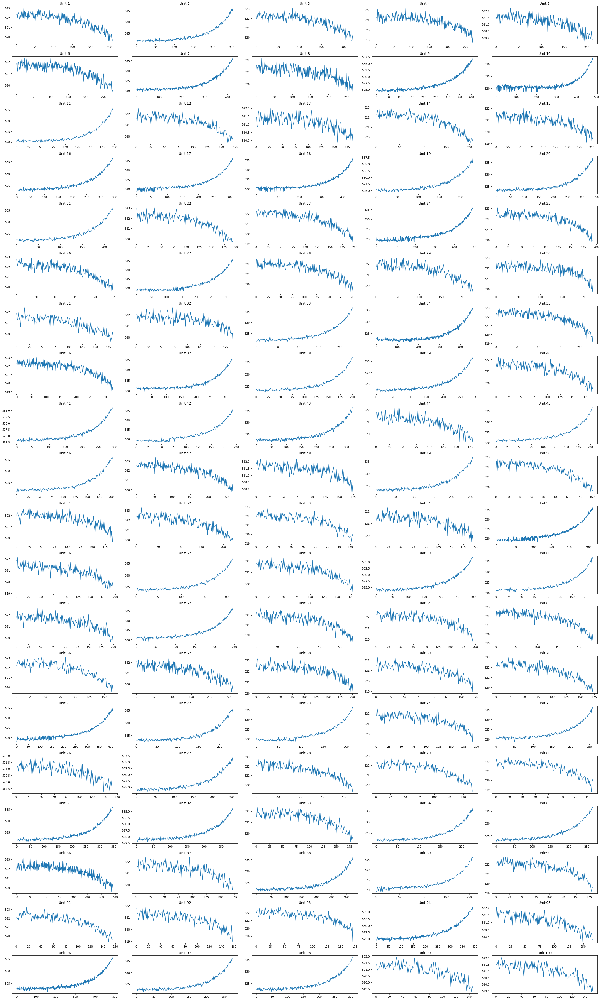

In [166]:
import seaborn as sns
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_3[df_train_3.ID == i+1], x = "Cycle", y = "sensor_measurement_12", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()